In [1]:
# import Libs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation

from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

### Kmean

import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.cluster import KMeans
import sklearn.metrics as sm

In [350]:
# Load Data
df = pd.read_csv("data/globalterrorismdb_0617dist.csv")
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [336]:
#  iyear, imonth, iday, extended, 
# df
df.count()

eventid               170350
iyear                 170350
imonth                170350
iday                  170350
approxdate              7464
extended              170350
resolution              2219
country               170350
country_txt           170350
region                170350
region_txt            170350
provstate             155848
city                  169904
latitude              165744
longitude             165744
specificity           170346
vicinity              170350
location               47974
summary               104212
crit1                 170350
crit2                 170350
crit3                 170350
doubtterr             170350
alternative            26631
alternative_txt        26631
multiple              170350
success               170350
suicide               170350
attacktype1           170350
attacktype1_txt       170350
                       ...  
propextent             60545
propextent_txt         60545
propvalue              35487
propcomment   

In [351]:
# selected attributes and autofill
selected_df = df[['iyear','imonth','iday','resolution','crit1','crit2','crit3','multiple',
                  'country','region','city','specificity',
                  'attacktype1','success','suicide',
                  'weaptype1','weapsubtype1',
                  'targtype1','targsubtype1','corp1','target1','natlty1',
                  'gname','gsubname','guncertain1','individual','nperps','nperpcap','claimed','claimmode','compclaim',
                  'nkill','nkillter','nwound','nwoundte','property','propextent',
                  'INT_LOG','INT_IDEO','INT_MISC','INT_ANY']]

selected_df.dtypes
selected_df.describe([.10, .25, .5, .75, .90])

,iyear,imonth,iday,crit1,crit2,crit3,multiple,country,region,specificity,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,170350.000000,170350.000000,170350.000000,170350.000000,170350.000000,170350.000000,170350.000000,170350.000000,170350.000000,170346.000000,...,160668.000000,103687.000000,155025.000000,101601.000000,170350.000000,60545.000000,170350.000000,170350.000000,170350.000000,170350.000000
mean,2001.709997,6.474365,15.466845,0.988441,0.992985,0.879818,0.134206,132.526669,7.091441,1.454428,...,2.387246,0.478864,3.200239,0.097322,-0.505970,3.299777,-4.583387,-4.510555,0.091083,-3.975128
std,13.144146,3.392364,8.817929,0.106888,0.083461,0.325175,0.340875,112.848161,2.949206,1.009005,...,11.327709,4.190902,34.647365,1.449435,3.095503,0.490277,4.542694,4.630440,0.583166,4.691492
min,1970.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,-9.000000,1.000000,-9.000000,-9.000000,-9.000000,-9.000000
10%,1982.000000,2.000000,3.000000,1.000000,1.000000,0.000000,0.000000,19.000000,3.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,-9.000000,3.000000,-9.000000,-9.000000,0.000000,-9.000000
25%,1990.000000,4.000000,8.000000,1.000000,1.000000,1.000000,0.000000,75.000000,5.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2007.000000,6.000000,15.000000,1.000000,1.000000,1.000000,0.000000,98.000000,6.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2014.000000,9.000000,23.000000,1.000000,1.000000,1.000000,0.000000,160.000000,10.000000,1.000000,...,2.000000,0.000000,2.000000,0.000000,1.000000,4.000000,0.000000,0.000000,0.000000,0.000000
90%,2015.000000,11.000000,28.000000,1.000000,1.000000,1.000000,1.000000,209.000000,10.000000,3.000000,...,5.000000,1.000000,7.000000,0.000000,1.000000,4.000000,0.000000,1.000000,1.000000,1.000000
max,2016.000000,12.000000,31.000000,1.000000,1.000000,1.000000,1.000000,1004.000000,12.000000,5.000000,...,1500.000000,500.000000,7366.000000,200.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000


In [340]:
selected_txt_df = df[['iyear','imonth','iday','resolution','crit1','crit2','crit3','multiple',
                  'country_txt','region_txt','city','specificity',
                  'attacktype1_txt','success','suicide',
                  'weaptype1_txt','weapsubtype1_txt',
                  'targtype1_txt','targsubtype1_txt','corp1','target1','natlty1_txt',
                  'gname','gsubname','guncertain1','individual','nperps','nperpcap','claimed','claimmode','compclaim',
                  'nkill','nkillter','nwound','nwoundte','property','propextent_txt',
                  'INT_LOG','INT_IDEO','INT_MISC','INT_ANY']]
#selected_txt_df = check_time_data(selected_txt_df)
selected_txt_df.head()
selected_txt_df.to_csv('data/selected_txt_data_v2.csv')

In [353]:
# types
selected_df.dtypes

iyear             int64
imonth            int64
iday              int64
resolution       object
crit1             int64
crit2             int64
crit3             int64
multiple          int64
country           int64
region            int64
city             object
specificity     float64
attacktype1       int64
success           int64
suicide           int64
weaptype1         int64
weapsubtype1    float64
targtype1         int64
targsubtype1    float64
corp1            object
target1          object
natlty1         float64
gname            object
gsubname         object
guncertain1     float64
individual        int64
nperps          float64
nperpcap        float64
claimed         float64
claimmode       float64
compclaim       float64
nkill           float64
nkillter        float64
nwound          float64
nwoundte        float64
property          int64
propextent      float64
INT_LOG           int64
INT_IDEO          int64
INT_MISC          int64
INT_ANY           int64
dtype: object

In [354]:
# modify resolution and iday, imonth
def check_time_data(df):
    timestamp_date = []
    
    for index, eachRow in df.iterrows():

        if eachRow['iday'] == 0 and eachRow['resolution'] != 0:
            #print index
            #print 'iday = 0'
            eachRow['iday'] = 1
            df['iday'][index] = 1
        elif eachRow['iday'] == 0 and eachRow['imonth'] == 0:
            eachRow['iday'] = 1
            df['iday'][index] = 1

        if eachRow['imonth'] == 0 and pd.isna(eachRow['resolution']) == False:
            temp = eachRow['resolution'].split('/')
            eachRow['imonth'] = temp[0]
            df['imonth'][index] = temp[0]
        elif eachRow['imonth'] == 0:
            eachRow['imonth'] = 1
            df['imonth'][index] = 1

        if pd.isna(eachRow['resolution']) == False:
            #print index
            #temp =np.datetime64('2017-06-26')
            #print type(eachRow['resolution'])
            temp = eachRow['resolution'].split('/')
            if int(temp[0]) < 10:
                temp[0] = '0'+ str(temp[0])
            if int(temp[1]) < 10:
                temp[1] = '0'+str(temp[1])

            temp_date = pd.Timestamp(temp[2]+'-'+temp[0]+'-'+temp[1])

            eachRow_date = str(eachRow['iyear'])

            if eachRow['imonth'] < 10:
                eachRow_date = eachRow_date+'-0'+str(eachRow['imonth'])
            else:
                eachRow_date = eachRow_date+'-'+str(eachRow['imonth'])

            if eachRow['iday'] < 10:
                eachRow_date = eachRow_date+'-0'+str(eachRow['iday'])
            else:
                eachRow_date = eachRow_date+'-'+str(eachRow['iday'])
                
            eachRow_date = pd.Timestamp(eachRow_date)
            timestamp_date.append(eachRow_date)
            
            #print temp_date
            #print eachRow_date
            _temp = temp_date - eachRow_date
            #print _temp.days
            #print type(_temp)
            eachRow['resolution'] = _temp.days
            df['resolution'][index] = _temp.days
            
            #eachRow['resolution'] = _temp.
            #print type(.int())
            #print type(temp[2])
            #print eachRow['imonth']
            #print temp[1]
            #print int(eachRow['iyear']) == int(temp[2])
            #print int(eachRow['imonth']) == int(temp[0])
            #if int(eachRow['iyear']) == int(temp[2]) and int(eachRow['imonth']) == int(temp[0]):
            #    eachRow['resolution'] = np.int64(temp[0]) - np.int64(eachRow['iday'])
            #elif int(eachRow['iyear']) == int(temp[2]) and int(eachRow['imonth']) == int(temp[0])-1:
            #    eachRow['resolution'] = np.int64(temp[0]) - np.int64(eachRow['iday'])
            #else:
            #    print index
            #    print 'not in month'
    #df['timestamp'] = pd.Series(timestamp_date, index=df.index)
    return df

In [355]:
# Run func check_time_data
selected_df = check_time_data(selected_df)

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is tr

In [356]:
# modify resolution
#a = selected_df['resolution'][112].split('/')
#print type(a[2])
#print type(selected_df['iyear'][112])
#int(selected_df['iyear'][112]) == int(a[2])
#b = np.datetime64(a[2]+'-0'+a[0]+'-1'+a[1])
# b.date()
print selected_df['resolution'][1617]
selected_df.count()
selected_df['resolution'].describe()

0


count     2219
unique     236
top          1
freq       546
Name: resolution, dtype: int64

In [5]:
#selected_df.fillna(-10,inplace = True)
selected_df['city'] = selected_df['city'].fillna('UNKNOWN')
selected_df['corp1'] = selected_df['corp1'].fillna('UNKNOWN')
selected_df['target1']= selected_df['target1'].fillna('UNKNOWN')
selected_df['gname']= selected_df['gname'].fillna('UNKNOW')
selected_df['gsubname']= selected_df['gsubname'].fillna('UNKNOWN')


selected_df = selected_df.fillna(-10)

selected_df['specificity'] = selected_df['specificity'].astype('int64')
selected_df['weapsubtype1']= selected_df['weapsubtype1'].astype('int64')
selected_df['targsubtype1'] =selected_df['targsubtype1'].astype('int64')
selected_df['natlty1'] = selected_df['natlty1'].astype('int64')
selected_df['guncertain1'] = selected_df['guncertain1'].astype('int64')
selected_df['nperps'] = selected_df['nperps'].astype('int64')
selected_df['nperpcap'] = selected_df['nperpcap'].astype('int64')
selected_df['claimed'] = selected_df['claimed'].astype('int64')
selected_df['claimmode'] = selected_df['claimmode'].astype('int64')
selected_df['compclaim'] = selected_df['compclaim'].astype('int64')
selected_df['nkill'] = selected_df['nkill'].astype('int64')
selected_df['nkillter'] = selected_df['nkillter'].astype('int64')
selected_df['nwound'] = selected_df['nwound'].astype('int64')
selected_df['nwoundte'] = selected_df['nwoundte'].astype('int64')
selected_df['propextent'] = selected_df['propextent'].astype('int64')

selected_df = selected_df.fillna(-10)

selected_df.head()

,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,region,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,1970,7,2,-10.0,1,1,1,0,58,2,...,1,-10,0,-10,0,-10,0,0,0,0
1,1970,1,1,-10.0,1,1,1,0,130,1,...,0,-10,0,-10,0,-10,0,1,1,1
2,1970,1,1,-10.0,1,1,1,0,160,5,...,1,-10,0,-10,0,-10,-9,-9,1,1
3,1970,1,1,-10.0,1,1,1,0,78,8,...,-10,-10,-10,-10,1,-10,-9,-9,1,1
4,1970,1,1,-10.0,1,1,1,0,101,4,...,-10,-10,-10,-10,1,-10,-9,-9,1,1


In [358]:
selected_df.to_csv('data/selected_data_final.csv')
selected_df.head()

,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,region,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,1970,7,2,NaN,1,1,1,0,58,2,...,1.0,NaN,0.0,NaN,0,NaN,0,0,0,0
1,1970,1,1,NaN,1,1,1,0,130,1,...,0.0,NaN,0.0,NaN,0,NaN,0,1,1,1
2,1970,1,1,NaN,1,1,1,0,160,5,...,1.0,NaN,0.0,NaN,0,NaN,-9,-9,1,1
3,1970,1,1,NaN,1,1,1,0,78,8,...,NaN,NaN,NaN,NaN,1,NaN,-9,-9,1,1
4,1970,1,1,NaN,1,1,1,0,101,4,...,NaN,NaN,NaN,NaN,1,NaN,-9,-9,1,1


In [327]:
selected_df.dtypes

Unnamed: 0        int64
Unnamed: 0.1      int64
iyear             int64
imonth            int64
iday              int64
resolution        int64
crit1             int64
crit2             int64
crit3             int64
multiple          int64
country           int64
region            int64
specificity       int64
attacktype1       int64
success         float64
suicide           int64
weaptype1         int64
weapsubtype1      int64
targtype1         int64
targsubtype1      int64
natlty1           int64
guncertain1       int64
individual        int64
nperps            int64
nperpcap          int64
claimed           int64
claimmode         int64
compclaim         int64
nkill             int64
nkillter          int64
nwound            int64
nwoundte          int64
property          int64
propextent        int64
INT_LOG           int64
INT_IDEO          int64
INT_MISC          int64
INT_ANY           int64
dtype: object

In [3]:
selected_df = pd.read_csv("data/selected_data_final.csv")

#del selected_df['Unnamed: 0']
#del selected_df['Unnamed: 0.1']
#del selected_df['Unnamed: 0.1.1']
#del selected_df['target1']
#del selected_df['gname']
#del selected_df['gsubname']
selected_df['success'].describe()

count    170350.000000
mean          0.896396
std           0.304747
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: success, dtype: float64

In [98]:
# Classification

#split dataset in features and target variable
feature_cols = ['iyear','imonth','iday','resolution','crit1','crit2','crit3','multiple',
                 'country','region',#'city',
                'specificity',
                  'attacktype1','success',
                  #'weaptype1','weapsubtype1',
                  'targtype1','targsubtype1',#'corp1','target1',
                'natlty1',
                  #'gname','gsubname',
                'guncertain1','individual','nperps','nperpcap','claimed','claimmode','compclaim',
                  #'nkill','nkillter','nwound','nwoundte','property','propextent',
                  'INT_LOG','INT_IDEO','INT_MISC','INT_ANY'
]
 
X = selected_df[feature_cols] # Features
y = selected_df.suicide # Target variable

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1) # 80% training and 20% test
# guarantee that the output of Run 1 will be equal to the output of Run 2,

# Create Decision Tree classifer object
# criterion = "gini"
# max_depth = none to get the maximum
clf_decisionTree = DecisionTreeClassifier(criterion="gini", max_depth=5)

# Train Decision Tree Classifer
clf_decisionTree = clf_decisionTree.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf_decisionTree.predict(X_test)

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

print X_train.count()
print X_test.count()

('Accuracy:', 0.9796301731728794)
iyear           136280
imonth          136280
iday            136280
resolution      136280
crit1           136280
crit2           136280
crit3           136280
multiple        136280
country         136280
region          136280
specificity     136280
attacktype1     136280
success         136280
targtype1       136280
targsubtype1    136280
natlty1         136280
guncertain1     136280
individual      136280
nperps          136280
nperpcap        136280
claimed         136280
claimmode       136280
compclaim       136280
INT_LOG         136280
INT_IDEO        136280
INT_MISC        136280
INT_ANY         136280
dtype: int64
iyear           34070
imonth          34070
iday            34070
resolution      34070
crit1           34070
crit2           34070
crit3           34070
multiple        34070
country         34070
region          34070
specificity     34070
attacktype1     34070
success         34070
targtype1       34070
targsubtype1    34070
na

In [357]:
selected_df['success'].describe()

count    170350.000000
mean          0.896396
std           0.304747
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: success, dtype: float64

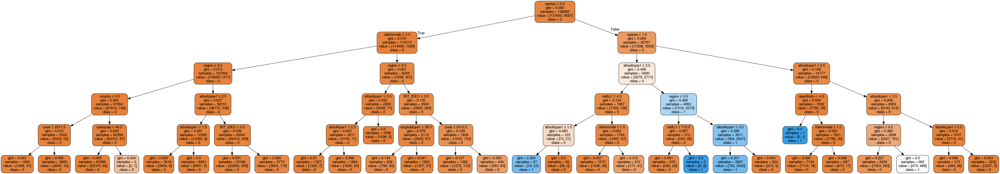

In [99]:
dot_data = StringIO()
export_graphviz(clf_decisionTree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

In [86]:
# Get numerical feature importances
importances_Tree = list(clf_decisionTree.feature_importances_)
# List of tuples with variable and importance
feature_importances_Tree = [(feature, round(importance, 2)) for feature, importance in zip(feature_cols, importances_Tree)]
# Sort the feature importances by most important first
feature_importances_Tree = sorted(feature_importances_Tree, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
print feature_importances_Tree
#[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

[('targsubtype1', 0.29), ('targtype1', 0.23), ('nperpcap', 0.13), ('weapsubtype1', 0.08), ('country', 0.05), ('nperps', 0.05), ('region', 0.04), ('natlty1', 0.04), ('weaptype1', 0.03), ('specificity', 0.01), ('guncertain1', 0.01), ('claimed', 0.01), ('claimmode', 0.01), ('INT_LOG', 0.01), ('INT_IDEO', 0.01), ('individual', 0.0), ('compclaim', 0.0), ('INT_MISC', 0.0), ('INT_ANY', 0.0)]


In [363]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support

cm = confusion_matrix(y_test, y_pred)
precision, recall, f_score, support = precision_recall_fscore_support(y_test, y_pred)
precision_recall_fscore_support(y_test, y_pred)  # per label
print (precision, recall, f_score, support)
fig, ax = plt.subplots()
im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)
# We want to show all ticks...
ax.set(xticks=np.arange(cm.shape[1]),
       yticks=np.arange(cm.shape[0]),
       # ... and label them with the respective list entries
       xticklabels=['nonSuccess','success'], yticklabels=['nonSuccess','success'],
       title=None,
       ylabel='True label',
       xlabel='Predicted label')


ValueError: Classification metrics can't handle a mix of continuous and binary targets

In [286]:
from sklearn.model_selection import GridSearchCV

parameters={'min_samples_split' : range(10,500,2),'max_depth': range(1,20,2),'criterion': ['gini', 'entropy']}
clf_tree=DecisionTreeClassifier()
clf_tree=GridSearchCV(clf_tree,parameters)
clf_tree.fit(X_train,y_train)

GridSearchCV(cv=None, error_score='raise',
       estimator=DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best'),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'min_samples_split': [10, 30, 50, 70, 90, 110, 130, 150, 170, 190, 210, 230, 250, 270, 290, 310, 330, 350, 370, 390, 410, 430, 450, 470, 490], 'criterion': ['gini', 'entropy'], 'max_depth': [1, 3, 5, 7]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [5]:
selected_df = pd.read_csv("data/selected_data_final.csv")
selected_df.head()

,Unnamed: 0,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,0,1970,7,2,NaN,1,1,1,0,58,...,1.0,NaN,0.0,NaN,0,NaN,0,0,0,0
1,1,1970,1,1,NaN,1,1,1,0,130,...,0.0,NaN,0.0,NaN,0,NaN,0,1,1,1
2,2,1970,1,1,NaN,1,1,1,0,160,...,1.0,NaN,0.0,NaN,0,NaN,-9,-9,1,1
3,3,1970,1,1,NaN,1,1,1,0,78,...,NaN,NaN,NaN,NaN,1,NaN,-9,-9,1,1
4,4,1970,1,1,NaN,1,1,1,0,101,...,NaN,NaN,NaN,NaN,1,NaN,-9,-9,1,1


In [6]:
del selected_df['Unnamed: 0']
#selected_df.fillna(-10,inplace = True)
selected_df['city'] = selected_df['city'].fillna('UNKNOWN')
selected_df['corp1'] = selected_df['corp1'].fillna('UNKNOWN')
selected_df['target1']= selected_df['target1'].fillna('UNKNOWN')
selected_df['gname']= selected_df['gname'].fillna('UNKNOW')
selected_df['gsubname']= selected_df['gsubname'].fillna('UNKNOWN')


selected_df = selected_df.fillna(-10)

selected_df['specificity'] = selected_df['specificity'].astype('int64')
selected_df['weapsubtype1']= selected_df['weapsubtype1'].astype('int64')
selected_df['targsubtype1'] =selected_df['targsubtype1'].astype('int64')
selected_df['natlty1'] = selected_df['natlty1'].astype('int64')
selected_df['guncertain1'] = selected_df['guncertain1'].astype('int64')
selected_df['nperps'] = selected_df['nperps'].astype('int64')
selected_df['nperpcap'] = selected_df['nperpcap'].astype('int64')
selected_df['claimed'] = selected_df['claimed'].astype('int64')
selected_df['claimmode'] = selected_df['claimmode'].astype('int64')
selected_df['compclaim'] = selected_df['compclaim'].astype('int64')
selected_df['nkill'] = selected_df['nkill'].astype('int64')
selected_df['nkillter'] = selected_df['nkillter'].astype('int64')
selected_df['nwound'] = selected_df['nwound'].astype('int64')
selected_df['nwoundte'] = selected_df['nwoundte'].astype('int64')
selected_df['propextent'] = selected_df['propextent'].astype('int64')
selected_df['resolution'] = selected_df['resolution'].astype('int64')

selected_df.head()

,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,region,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,1970,7,2,-10,1,1,1,0,58,2,...,1,-10,0,-10,0,-10,0,0,0,0
1,1970,1,1,-10,1,1,1,0,130,1,...,0,-10,0,-10,0,-10,0,1,1,1
2,1970,1,1,-10,1,1,1,0,160,5,...,1,-10,0,-10,0,-10,-9,-9,1,1
3,1970,1,1,-10,1,1,1,0,78,8,...,-10,-10,-10,-10,1,-10,-9,-9,1,1
4,1970,1,1,-10,1,1,1,0,101,4,...,-10,-10,-10,-10,1,-10,-9,-9,1,1


In [4]:
selected_df.to_csv('data/selected_final_v2.csv')

In [30]:
print y

0          2
1          1
2          5
3          8
4          4
5          1
6          3
7          1
8          1
9          1
10         1
11         1
12         8
13         1
14         1
15         9
16        11
17         1
18         1
19         1
20         1
21         3
22         1
23         1
24         1
25         2
26         5
27         3
28         1
29         1
          ..
170320     5
170321     6
170322     6
170323    10
170324     6
170325    11
170326     6
170327     6
170328     6
170329     6
170330    11
170331    10
170332    10
170333    10
170334    10
170335    10
170336    10
170337    10
170338     6
170339     6
170340     6
170341     6
170342     6
170343     6
170344     6
170345    11
170346     5
170347    11
170348     1
170349    11
Name: region, Length: 170350, dtype: int64


In [45]:
# Cross-validation
from sklearn import tree
from sklearn.cross_validation import cross_val_score
from sklearn.model_selection import GridSearchCV


#selected_df['success'] = selected_df['success'].map({'nonSuccess':0,'Success':1})
feature_cols = ['iyear','imonth','iday','resolution','crit1','crit2','crit3','multiple',
                  'country',#'region',#'city',
                'specificity',
                  'attacktype1','suicide',
                  'weaptype1','weapsubtype1',
                  'targtype1','targsubtype1',#'corp1','target1',
                'natlty1', 
                'success', 
                  #'gname','gsubname',
                'guncertain1','individual','nperps','nperpcap','claimed','claimmode','compclaim',
                'nkill','nkillter','nwound','nwoundte','property','propextent',
                  'INT_LOG','INT_IDEO','INT_MISC','INT_ANY']
 
X = selected_df[feature_cols] # Features
#y = selected_df.success # Target variable
y = selected_df.region

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1) # 80% training and 20% test

print X.count()
print y.count()

parameters={'min_samples_split' : range(2,20,2),'max_depth': range(3,20,1),'criterion': ['gini', 'entropy']}
clf_tree_ = GridSearchCV(tree.DecisionTreeClassifier(), parameters, n_jobs=4,cv=3, verbose = 2)
clf_tree_.fit(X=X_train, y=y_train)
tree_model = clf_tree_.best_estimator_
print (clf_tree_.best_score_, clf_tree_.best_params_) 


iyear           170350
imonth          170350
iday            170350
resolution      170350
crit1           170350
crit2           170350
crit3           170350
multiple        170350
country         170350
specificity     170350
attacktype1     170350
suicide         170350
weaptype1       170350
weapsubtype1    170350
targtype1       170350
targsubtype1    170350
natlty1         170350
success         170350
guncertain1     170350
individual      170350
nperps          170350
nperpcap        170350
claimed         170350
claimmode       170350
compclaim       170350
nkill           170350
nkillter        170350
nwound          170350
nwoundte        170350
property        170350
propextent      170350
INT_LOG         170350
INT_IDEO        170350
INT_MISC        170350
INT_ANY         170350
dtype: int64
170350
Fitting 3 folds for each of 306 candidates, totalling 918 fits
[CV] min_samples_split=2, criterion=gini, max_depth=3 ................
[CV] min_samples_split=2, criterion=gini,

[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:    4.6s


[CV] min_samples_split=8, criterion=gini, max_depth=4 ................
[CV] . min_samples_split=6, criterion=gini, max_depth=4, total=   0.5s
[CV] min_samples_split=10, criterion=gini, max_depth=4 ...............
[CV] . min_samples_split=8, criterion=gini, max_depth=4, total=   0.4s
[CV] . min_samples_split=8, criterion=gini, max_depth=4, total=   0.4s
[CV] min_samples_split=10, criterion=gini, max_depth=4 ...............
[CV] min_samples_split=10, criterion=gini, max_depth=4 ...............
[CV] . min_samples_split=8, criterion=gini, max_depth=4, total=   0.4s
[CV] min_samples_split=12, criterion=gini, max_depth=4 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=4, total=   0.4s
[CV] min_samples_split=12, criterion=gini, max_depth=4 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=4, total=   0.3s
[CV] min_samples_split=12, criterion=gini, max_depth=4 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=4, total=   0.3s
[CV] m

[CV] min_samples_split=12, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=6, total=   0.4s
[CV] min_samples_split=12, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=6, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=6, total=   0.4s
[CV] min_samples_split=14, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=6, total=   0.4s
[CV] min_samples_split=14, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=6, total=   0.5s
[CV] min_samples_split=14, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=6, total=   0.5s
[CV]  min_samples_split=14, criterion=gini, max_depth=6, total=   0.4s
[CV] min_samples_split=16, criterion=gini, max_depth=6 ...............
[CV] m

[CV] min_samples_split=14, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=14, criterion=gini, max_depth=8, total=   0.5s
[CV]  min_samples_split=12, criterion=gini, max_depth=8, total=   0.6s
[CV] min_samples_split=14, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=16, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=14, criterion=gini, max_depth=8, total=   0.4s
[CV] min_samples_split=16, criterion=gini, max_depth=8 ...............
[CV] min_samples_split=16, criterion=gini, max_depth=8 ...............


[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:   20.5s


[CV]  min_samples_split=16, criterion=gini, max_depth=8, total=   0.3s
[CV] min_samples_split=18, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=14, criterion=gini, max_depth=8, total=   0.5s
[CV] min_samples_split=18, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=16, criterion=gini, max_depth=8, total=   0.5s
[CV] min_samples_split=18, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=16, criterion=gini, max_depth=8, total=   0.5s
[CV] min_samples_split=2, criterion=gini, max_depth=9 ................
[CV]  min_samples_split=18, criterion=gini, max_depth=8, total=   0.4s
[CV] min_samples_split=2, criterion=gini, max_depth=9 ................
[CV]  min_samples_split=18, criterion=gini, max_depth=8, total=   0.4s
[CV] min_samples_split=2, criterion=gini, max_depth=9 ................
[CV]  min_samples_split=18, criterion=gini, max_depth=8, total=   0.6s
[CV] min_samples_split=4, criterion=gini, max_depth=9 ................
[CV] .

[CV]  min_samples_split=18, criterion=gini, max_depth=10, total=   0.6s
[CV] min_samples_split=2, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=18, criterion=gini, max_depth=10, total=   0.5s
[CV] min_samples_split=2, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=18, criterion=gini, max_depth=10, total=   0.5s
[CV] min_samples_split=4, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=11, total=   0.6s
[CV] min_samples_split=4, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=11, total=   0.6s
[CV] min_samples_split=4, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=11, total=   0.6s
[CV] min_samples_split=6, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=11, total=   0.5s
[CV] min_samples_split=6, criterion=gini, max_depth=11 ...............
[CV

[CV] min_samples_split=4, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=13, total=   0.6s
[CV] min_samples_split=4, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=13, total=   0.5s
[CV] min_samples_split=6, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=13, total=   0.6s
[CV] min_samples_split=6, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=13, total=   0.5s
[CV] min_samples_split=6, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=13, total=   0.6s
[CV] min_samples_split=8, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=13, total=   0.5s
[CV] min_samples_split=8, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=13, total=   0.6s
[CV] m

[CV]  min_samples_split=4, criterion=gini, max_depth=15, total=   0.6s
[CV] min_samples_split=6, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=15, total=   0.6s
[CV] min_samples_split=8, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=15, total=   0.6s
[CV] min_samples_split=8, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=15, total=   0.6s
[CV] min_samples_split=8, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=15, total=   0.5s
[CV] min_samples_split=10, criterion=gini, max_depth=15 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=15, total=   0.7s
[CV] min_samples_split=10, criterion=gini, max_depth=15 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=15, total=   0.6s
[CV] min_samples_split=10, criterion=gini, max_depth=15 ..............
[CV]  

[Parallel(n_jobs=4)]: Done 357 tasks      | elapsed:   54.2s


[CV]  min_samples_split=6, criterion=gini, max_depth=16, total=   0.8s
[CV] min_samples_split=8, criterion=gini, max_depth=16 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=16, total=   0.7s
[CV] min_samples_split=10, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=16, total=   0.9s
[CV] min_samples_split=10, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=16, total=   1.0s
[CV] min_samples_split=10, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=16, total=   0.7s
[CV] min_samples_split=12, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=16, total=   0.5s
[CV] min_samples_split=12, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=16, total=   0.7s
[CV] min_samples_split=12, criterion=gini, max_depth=16 ..............
[CV]

[CV] min_samples_split=10, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=18, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=18, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=18, total=   0.7s
[CV] min_samples_split=12, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=18, total=   0.7s
[CV] min_samples_split=14, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=12, criterion=gini, max_depth=18, total=   0.5s
[CV] min_samples_split=14, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=12, criterion=gini, max_depth=18, total=   0.6s
[CV] min_samples_split=14, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=12, criterion=gini, max_depth=18, total=   0.6s


[CV]  min_samples_split=10, criterion=entropy, max_depth=3, total=   0.3s
[CV]  min_samples_split=12, criterion=entropy, max_depth=3, total=   0.2s
[CV] min_samples_split=14, criterion=entropy, max_depth=3 ............
[CV] min_samples_split=14, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=12, criterion=entropy, max_depth=3, total=   0.3s
[CV] min_samples_split=14, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=12, criterion=entropy, max_depth=3, total=   0.3s
[CV] min_samples_split=16, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=3, total=   0.3s
[CV]  min_samples_split=14, criterion=entropy, max_depth=3, total=   0.2s
[CV] min_samples_split=16, criterion=entropy, max_depth=3 ............
[CV] min_samples_split=16, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=3, total=   0.3s
[CV] min_samples_split=18, criterion=entropy, max_depth=

[CV]  min_samples_split=12, criterion=entropy, max_depth=5, total=   0.4s
[CV] min_samples_split=16, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=5, total=   0.4s
[CV] min_samples_split=16, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=5, total=   0.4s
[CV] min_samples_split=16, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=5, total=   0.4s
[CV] min_samples_split=18, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=5, total=   0.4s
[CV] min_samples_split=18, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=5, total=   0.3s
[CV] min_samples_split=18, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=5, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=6

[CV] min_samples_split=16, criterion=entropy, max_depth=7 ............
[CV] min_samples_split=18, criterion=entropy, max_depth=7 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=7, total=   0.4s
[CV] min_samples_split=18, criterion=entropy, max_depth=7 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=7, total=   0.6s
[CV] min_samples_split=18, criterion=entropy, max_depth=7 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=7, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=8 .............
[CV]  min_samples_split=18, criterion=entropy, max_depth=7, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=8 .............
[CV]  min_samples_split=18, criterion=entropy, max_depth=7, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=8 .............
[CV]  min_samples_split=18, criterion=entropy, max_depth=7, total=   0.6s
[CV] min_samples_split=4, criterion=entropy, max_depth=8 ..

[Parallel(n_jobs=4)]: Done 640 tasks      | elapsed:  1.6min


[CV]  min_samples_split=14, criterion=entropy, max_depth=9, total=   0.6s
[CV] min_samples_split=16, criterion=entropy, max_depth=9 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=9, total=   0.5s
[CV]  min_samples_split=14, criterion=entropy, max_depth=9, total=   0.6s
[CV] min_samples_split=18, criterion=entropy, max_depth=9 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=9, total=   0.5s
[CV] min_samples_split=18, criterion=entropy, max_depth=9 ............
[CV] min_samples_split=18, criterion=entropy, max_depth=9 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=9, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=10 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=9, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=10 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=9, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=1

[CV] min_samples_split=18, criterion=entropy, max_depth=11 ...........
[CV]  min_samples_split=16, criterion=entropy, max_depth=11, total=   0.7s
[CV] min_samples_split=18, criterion=entropy, max_depth=11 ...........
[CV]  min_samples_split=16, criterion=entropy, max_depth=11, total=   0.7s
[CV] min_samples_split=2, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=11, total=   0.8s
[CV]  min_samples_split=18, criterion=entropy, max_depth=11, total=   0.6s
[CV] min_samples_split=2, criterion=entropy, max_depth=12 ............
[CV] min_samples_split=2, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=11, total=   0.6s
[CV] min_samples_split=4, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=12, total=   0.7s
[CV] min_samples_split=4, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=2, criterion=entropy, max_dept

[CV]  min_samples_split=18, criterion=entropy, max_depth=13, total=   0.7s
[CV] min_samples_split=2, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=13, total=   0.5s
[CV] min_samples_split=2, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=13, total=   0.5s
[CV] min_samples_split=4, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=14, total=   0.7s
[CV] min_samples_split=4, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=14, total=   0.6s
[CV]  min_samples_split=2, criterion=entropy, max_depth=14, total=   0.7s
[CV] min_samples_split=4, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=14, total=   0.5s
[CV] min_samples_split=6, criterion=entropy, max_depth=14 ............
[CV] min_samples_split=6, criterion=entropy, max_dept

[CV] min_samples_split=4, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=16, total=   0.7s
[CV] min_samples_split=4, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=16, total=   0.6s
[CV] min_samples_split=4, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=16, total=   0.6s
[CV] min_samples_split=6, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=16, total=   0.6s
[CV] min_samples_split=6, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=16, total=   0.6s
[CV] min_samples_split=6, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=16, total=   0.6s
[CV] min_samples_split=8, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=16,

[CV]  min_samples_split=2, criterion=entropy, max_depth=18, total=   0.9s
[CV]  min_samples_split=4, criterion=entropy, max_depth=18, total=   0.7s
[CV] min_samples_split=6, criterion=entropy, max_depth=18 ............
[CV] min_samples_split=6, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=18, total=   0.7s
[CV] min_samples_split=6, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=18, total=   0.7s
[CV] min_samples_split=8, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=18, total=   0.7s
[CV] min_samples_split=8, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=18, total=   0.6s
[CV] min_samples_split=8, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=18, total=   0.7s
[CV] min_samples_split=10, criterion=entropy, max_depth=

[Parallel(n_jobs=4)]: Done 918 out of 918 | elapsed:  2.5min finished


(0.9984443792192544, {'min_samples_split': 2, 'criterion': 'entropy', 'max_depth': 18})


In [29]:
# build with the best parameter
# (0.95417522747285, {'min_samples_split': 18, 'criterion': 'entropy', 'max_depth': 10})
# (0.9124816554153214, {'min_samples_split': 8, 'criterion': 'gini', 'max_depth': 8})
# (0.9123055474024068, {'min_samples_split': 4, 'criterion': 'gini', 'max_depth': 6})

parameters_Tree_best = {'min_samples_split': 8, 'criterion': 'gini', 'max_depth': 8}
clf_tree_Final = DecisionTreeClassifier(min_samples_split= 2, criterion= 'gini', max_depth= 5)
clf_tree_Final.fit(X_train,y_train)

y_pred = clf_tree_Final.predict(X_test)

#cm = confusion_matrix(y_test, y_pred)

precision, recall, f_score, support = precision_recall_fscore_support(y_test, y_pred)

precision_recall_fscore_support(y_test, y_pred)  # per label

print (precision, recall, f_score, support)
print metrics.accuracy_score(y_test, y_pred)
print y_pred
print y_test

(array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]), array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]), array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]), array([ 650, 2134, 3765,  161, 2220, 8235,  116, 3210, 1036, 9421, 3082,
         40]))
1.0
[11 10 10 ... 10 10 10]
152467    11
126483    10
137987    10
1956       1
13456      8
37719      2
62225      3
14304      2
102160    11
110892     6
40695      6
72291      5
102846     6
100366     6
145856    10
3015       5
52664      8
154169     6
139999    10
49689      3
17916      3
158828     6
65125      8
142066     6
9746       2
64891      9
37756      2
115779     6
146849    10
115917    10
          ..
22269      3
139865     6
37082     11
168113     5
143325    10
134126     6
64274     10
57024      8
112937    11
106019     6
77370     10
153270    10
132138    10
79728     10
159320     8
107313     6
59142      7
53815     11
155458    10
16659      5
163843     6
64400      3
123258    10
100458    

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.8978 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.8978 to fit



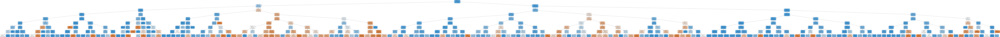

In [22]:
dot_data = StringIO()
export_graphviz(clf_tree_Final, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names = ['nonSuccess','success'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('decisionTree.png')
Image(graph.create_png())

(array([0.74672131, 0.91887367]), array([0.25475391, 0.98986686]), array([0.37989992, 0.95305001]), array([ 3576, 30494]))


0.9127091282653361

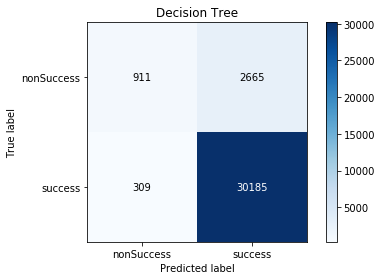

In [23]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support

y_pred = clf_tree_Final.predict(X_test)

cm = confusion_matrix(y_test, y_pred)
precision, recall, f_score, support = precision_recall_fscore_support(y_test, y_pred)
precision_recall_fscore_support(y_test, y_pred)  # per label

print (precision, recall, f_score, support)

normalize = False

fig, ax = plt.subplots()
im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)
# We want to show all ticks...
ax.set(xticks=np.arange(cm.shape[1]),
       yticks=np.arange(cm.shape[0]),
       # ... and label them with the respective list entries
       xticklabels=['nonSuccess','success'], yticklabels=['nonSuccess','success'],
       title='Decision Tree',
       ylabel='True label',
       xlabel='Predicted label')

fmt = '.2f' if normalize else 'd'
thresh = cm.max() / 2.
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        ax.text(j, i, format(cm[i, j], fmt),
                ha="center", va="center",
                color="white" if cm[i, j] > thresh else "black")
        
fig.tight_layout()

metrics.accuracy_score(y_test, y_pred)

In [24]:
# Get numerical feature importances
importances_Tree = list(clf_tree_Final.feature_importances_)
# List of tuples with variable and importance
feature_importances_Tree = [(feature, round(importance, 2)) for feature, importance in zip(feature_cols, importances_Tree)]
# Sort the feature importances by most important first
feature_importances_Tree = sorted(feature_importances_Tree, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
print feature_importances_Tree
#[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

[('targtype1', 0.19), ('targsubtype1', 0.18), ('attacktype1', 0.14), ('weapsubtype1', 0.14), ('nperpcap', 0.12), ('country', 0.05), ('nperps', 0.04), ('region', 0.03), ('weaptype1', 0.03), ('claimed', 0.02), ('specificity', 0.01), ('suicide', 0.01), ('natlty1', 0.01), ('INT_LOG', 0.01), ('INT_IDEO', 0.01), ('guncertain1', 0.0), ('individual', 0.0), ('claimmode', 0.0), ('compclaim', 0.0), ('INT_MISC', 0.0), ('INT_ANY', 0.0)]


In [ ]:
#####################################################################################################################

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.381869 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.381869 to fit



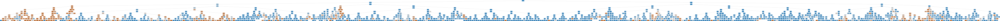

In [18]:
best_clf_tree = clf_tree_.best_estimator_
dot_data = StringIO()
export_graphviz(best_clf_tree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['nonSuccess','success'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

In [19]:
# Get numerical feature importances
importances = list(best_clf_tree.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_cols, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
print feature_importances
#[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

[('property', 0.25), ('attacktype1', 0.18), ('nkill', 0.12), ('nwound', 0.12), ('weapsubtype1', 0.09), ('nkillter', 0.05), ('iyear', 0.04), ('propextent', 0.03), ('claimed', 0.02), ('imonth', 0.01), ('iday', 0.01), ('country', 0.01), ('weaptype1', 0.01), ('targtype1', 0.01), ('targsubtype1', 0.01), ('natlty1', 0.01), ('nperps', 0.01), ('nwoundte', 0.01), ('resolution', 0.0), ('crit1', 0.0), ('crit2', 0.0), ('crit3', 0.0), ('multiple', 0.0), ('region', 0.0), ('specificity', 0.0), ('suicide', 0.0), ('guncertain1', 0.0), ('individual', 0.0), ('nperpcap', 0.0), ('claimmode', 0.0), ('compclaim', 0.0), ('INT_LOG', 0.0), ('INT_IDEO', 0.0), ('INT_MISC', 0.0), ('INT_ANY', 0.0)]


In [12]:
# random forest 
########## https://towardsdatascience.com/random-forest-in-python-24d0893d51c0
from sklearn.ensemble import RandomForestRegressor

# Instantiate model with 1000 decision trees
rf = RandomForestRegressor(n_estimators = 1000, random_state = 1)
# Train the model on training data
rf.fit(X_train,y_train)
# Use the forest's predict method on the test data
predictions = rf.predict(X_test)
# Calculate the absolute errors
errors = abs(predictions - y_test)
# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2), 'degrees.')


/usr/lib/python2.7/dist-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


KeyboardInterrupt: 

In [256]:
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot

## Limit depth of tree to 3 levels
##rf_small = RandomForestRegressor(n_estimators=10, max_depth = 3)
##rf_small.fit(train_features, train_labels)

# Pull out one tree from the forest
tree = rf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
# import pydot
# Pull out one tree from the forest
tree = rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = feature_cols, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')

In [263]:
# Get numerical feature importances
importances = list(rf.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_cols, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
print feature_importances
#[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

[('attacktype1', 0.17), ('property', 0.16), ('weapsubtype1', 0.08), ('targtype1', 0.07), ('nwound', 0.07), ('iyear', 0.06), ('iday', 0.06), ('nkill', 0.06), ('imonth', 0.04), ('targsubtype1', 0.04), ('country', 0.03), ('natlty1', 0.03), ('region', 0.02), ('nkillter', 0.02), ('crit3', 0.01), ('multiple', 0.01), ('specificity', 0.01), ('weaptype1', 0.01), ('nperps', 0.01), ('nwoundte', 0.01), ('propextent', 0.01), ('INT_LOG', 0.01), ('INT_IDEO', 0.01), ('INT_ANY', 0.01), ('resolution', 0.0), ('crit1', 0.0), ('crit2', 0.0), ('suicide', 0.0), ('guncertain1', 0.0), ('individual', 0.0), ('nperpcap', 0.0), ('claimed', 0.0), ('claimmode', 0.0), ('compclaim', 0.0), ('INT_MISC', 0.0)]


In [362]:
from sklearn.metrics import confusion_matrix
#print(confusion_matrix(y_test, predictions))
#print(classification_report(y_test, predictions))
predictions = rf.predict(X_test)
# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, predictions))

# Model Precision: what percentage of positive tuples are labeled as such?
print("Precision:",metrics.precision_score(y_test, predictions))

# Model Recall: what percentage of positive tuples are labelled as such?
print("Recall:",metrics.recall_score(y_test, predictions))

ValueError: continuous is not supported

In [13]:
####### Random Forest ############

from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
# Create the parameter grid based on the results of random search 
#param_grid = {
#    'bootstrap': [True],
#    'max_depth': [80, 90, 100, 110],
#    'max_features': [2, 3],
#    'min_samples_leaf': [3, 4, 5],
#    'min_samples_split': [8, 10, 12],
#    'n_estimators': [100, 200, 300, 1000]
#}

parameters_Forest={'min_samples_split' : range(2,20,2),'max_depth': range(3,20,1),'criterion': ['gini', 'entropy']}
# Create a based model
#rf = tree.RandomForestRegressor()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = RandomForestClassifier(), param_grid = parameters_Forest, 
                          cv = 3, n_jobs = 4, verbose = 2)
grid_search.fit(X=X_train, y=y_train)

tree_model_forest = grid_search.best_estimator_
print (grid_search.best_score_, grid_search.best_params_) 

Fitting 3 folds for each of 306 candidates, totalling 918 fits
[CV] min_samples_split=2, criterion=gini, max_depth=3 ................
[CV] min_samples_split=2, criterion=gini, max_depth=3 ................
[CV] min_samples_split=2, criterion=gini, max_depth=3 ................
[CV] min_samples_split=4, criterion=gini, max_depth=3 ................
[CV] . min_samples_split=2, criterion=gini, max_depth=3, total=   0.5s
[CV] min_samples_split=4, criterion=gini, max_depth=3 ................
[CV] . min_samples_split=2, criterion=gini, max_depth=3, total=   0.5s
[CV] min_samples_split=4, criterion=gini, max_depth=3 ................
[CV] . min_samples_split=4, criterion=gini, max_depth=3, total=   0.4s
[CV] . min_samples_split=2, criterion=gini, max_depth=3, total=   0.5s
[CV] min_samples_split=6, criterion=gini, max_depth=3 ................
[CV] min_samples_split=6, criterion=gini, max_depth=3 ................
[CV] . min_samples_split=4, criterion=gini, max_depth=3, total=   0.5s
[CV] min_sampl

[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:    6.2s


[CV] . min_samples_split=6, criterion=gini, max_depth=4, total=   0.5s
[CV] min_samples_split=8, criterion=gini, max_depth=4 ................
[CV] . min_samples_split=6, criterion=gini, max_depth=4, total=   0.8s
[CV] min_samples_split=10, criterion=gini, max_depth=4 ...............
[CV] . min_samples_split=8, criterion=gini, max_depth=4, total=   0.6s
[CV] min_samples_split=10, criterion=gini, max_depth=4 ...............
[CV] . min_samples_split=8, criterion=gini, max_depth=4, total=   0.6s
[CV] min_samples_split=10, criterion=gini, max_depth=4 ...............
[CV] . min_samples_split=8, criterion=gini, max_depth=4, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=4 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=4, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=4 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=4, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=4 ...............
[CV]  

[CV] . min_samples_split=8, criterion=gini, max_depth=6, total=   0.8s
[CV] min_samples_split=12, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=6, total=   0.6s
[CV]  min_samples_split=10, criterion=gini, max_depth=6, total=   0.6s
[CV] min_samples_split=12, criterion=gini, max_depth=6 ...............
[CV] min_samples_split=12, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=10, criterion=gini, max_depth=6, total=   0.7s
[CV] min_samples_split=14, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=6, total=   0.6s
[CV] min_samples_split=14, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=6, total=   0.6s
[CV] min_samples_split=14, criterion=gini, max_depth=6 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=6, total=   0.6s
[CV] min_samples_split=16, criterion=gini, max_depth=6 ...............
[CV]  

[CV]  min_samples_split=12, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=14, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=8, total=   0.9s
[CV] min_samples_split=14, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=12, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=16, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=14, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=16, criterion=gini, max_depth=8 ...............


[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:   33.4s


[CV]  min_samples_split=14, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=16, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=14, criterion=gini, max_depth=8, total=   0.7s
[CV] min_samples_split=18, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=16, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=18, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=16, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=18, criterion=gini, max_depth=8 ...............
[CV]  min_samples_split=16, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=2, criterion=gini, max_depth=9 ................
[CV]  min_samples_split=18, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=2, criterion=gini, max_depth=9 ................
[CV]  min_samples_split=18, criterion=gini, max_depth=8, total=   0.8s
[CV] min_samples_split=2, criterion=gini, max_depth=9 ................
[CV]  

[CV]  min_samples_split=16, criterion=gini, max_depth=10, total=   0.9s
[CV] min_samples_split=2, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=18, criterion=gini, max_depth=10, total=   0.9s
[CV]  min_samples_split=18, criterion=gini, max_depth=10, total=   0.8s
[CV] min_samples_split=2, criterion=gini, max_depth=11 ...............
[CV] min_samples_split=2, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=18, criterion=gini, max_depth=10, total=   0.8s
[CV] min_samples_split=4, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=11, total=   1.0s
[CV] min_samples_split=4, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=11, total=   1.0s
[CV] min_samples_split=4, criterion=gini, max_depth=11 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=11, total=   0.9s
[CV] min_samples_split=6, criterion=gini, max_depth=11 ...............
[C

[CV] min_samples_split=4, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=13, total=   1.3s
[CV]  min_samples_split=2, criterion=gini, max_depth=13, total=   1.2s
[CV] min_samples_split=4, criterion=gini, max_depth=13 ...............
[CV] min_samples_split=4, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=2, criterion=gini, max_depth=13, total=   1.1s
[CV] min_samples_split=6, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=13, total=   1.0s
[CV] min_samples_split=6, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=13, total=   1.1s
[CV] min_samples_split=6, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=13, total=   1.1s
[CV] min_samples_split=8, criterion=gini, max_depth=13 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=13, total=   1.1s
[CV] m

[CV]  min_samples_split=4, criterion=gini, max_depth=15, total=   1.2s
[CV] min_samples_split=6, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=15, total=   1.1s
[CV] min_samples_split=6, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=4, criterion=gini, max_depth=15, total=   1.1s
[CV] min_samples_split=8, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=15, total=   1.1s
[CV] min_samples_split=8, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=15, total=   1.2s
[CV] min_samples_split=8, criterion=gini, max_depth=15 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=15, total=   1.1s
[CV] min_samples_split=10, criterion=gini, max_depth=15 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=15, total=   1.1s
[CV] min_samples_split=10, criterion=gini, max_depth=15 ..............
[CV]  

[Parallel(n_jobs=4)]: Done 357 tasks      | elapsed:  1.6min


[CV]  min_samples_split=6, criterion=gini, max_depth=16, total=   1.2s
[CV] min_samples_split=8, criterion=gini, max_depth=16 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=16, total=   1.1s
[CV] min_samples_split=8, criterion=gini, max_depth=16 ...............
[CV]  min_samples_split=6, criterion=gini, max_depth=16, total=   1.2s
[CV] min_samples_split=10, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=16, total=   1.2s
[CV] min_samples_split=10, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=16, total=   1.1s
[CV] min_samples_split=10, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=16, total=   1.2s
[CV] min_samples_split=12, criterion=gini, max_depth=16 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=16, total=   1.3s
[CV] min_samples_split=12, criterion=gini, max_depth=16 ..............
[CV] 

[CV] min_samples_split=10, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=18, total=   1.2s
[CV] min_samples_split=10, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=8, criterion=gini, max_depth=18, total=   1.3s
[CV] min_samples_split=12, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=18, total=   1.2s
[CV] min_samples_split=12, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=18, total=   1.3s
[CV] min_samples_split=12, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=10, criterion=gini, max_depth=18, total=   1.2s
[CV] min_samples_split=14, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=12, criterion=gini, max_depth=18, total=   1.3s
[CV] min_samples_split=14, criterion=gini, max_depth=18 ..............
[CV]  min_samples_split=12, criterion=gini, max_depth=18, total=   1.3s
[

[CV]  min_samples_split=10, criterion=entropy, max_depth=3, total=   0.4s
[CV] min_samples_split=12, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=10, criterion=entropy, max_depth=3, total=   0.6s
[CV] min_samples_split=14, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=12, criterion=entropy, max_depth=3, total=   0.4s
[CV] min_samples_split=14, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=12, criterion=entropy, max_depth=3, total=   0.4s
[CV] min_samples_split=14, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=12, criterion=entropy, max_depth=3, total=   0.6s
[CV] min_samples_split=16, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=3, total=   0.4s
[CV] min_samples_split=16, criterion=entropy, max_depth=3 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=3, total=   0.5s
[CV] min_samples_split=16, criterion=entropy, max_depth=

[CV]  min_samples_split=12, criterion=entropy, max_depth=5, total=   0.5s
[CV] min_samples_split=14, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=12, criterion=entropy, max_depth=5, total=   0.6s
[CV] min_samples_split=16, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=5, total=   0.5s
[CV] min_samples_split=16, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=5, total=   0.6s
[CV] min_samples_split=16, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=5, total=   0.6s
[CV] min_samples_split=18, criterion=entropy, max_depth=5 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=5, total=   0.5s
[CV]  min_samples_split=16, criterion=entropy, max_depth=5, total=   0.6s
[CV] min_samples_split=18, criterion=entropy, max_depth=5 ............
[CV] min_samples_split=18, criterion=entropy, max_depth=

[CV] min_samples_split=16, criterion=entropy, max_depth=7 ............
[CV] min_samples_split=16, criterion=entropy, max_depth=7 ............
[CV]  min_samples_split=14, criterion=entropy, max_depth=7, total=   0.7s
[CV] min_samples_split=18, criterion=entropy, max_depth=7 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=7, total=   0.7s
[CV] min_samples_split=18, criterion=entropy, max_depth=7 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=7, total=   0.7s
[CV]  min_samples_split=16, criterion=entropy, max_depth=7, total=   0.7s
[CV] min_samples_split=18, criterion=entropy, max_depth=7 ............
[CV] min_samples_split=2, criterion=entropy, max_depth=8 .............
[CV]  min_samples_split=18, criterion=entropy, max_depth=7, total=   0.7s
[CV] min_samples_split=2, criterion=entropy, max_depth=8 .............
[CV]  min_samples_split=18, criterion=entropy, max_depth=7, total=   0.7s
[CV]  min_samples_split=18, criterion=entropy, max_depth=7,

[Parallel(n_jobs=4)]: Done 640 tasks      | elapsed:  2.9min


[CV] min_samples_split=18, criterion=entropy, max_depth=9 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=9, total=   0.8s
[CV] min_samples_split=18, criterion=entropy, max_depth=9 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=9, total=   0.8s
[CV] min_samples_split=18, criterion=entropy, max_depth=9 ............
[CV]  min_samples_split=16, criterion=entropy, max_depth=9, total=   0.8s
[CV] min_samples_split=2, criterion=entropy, max_depth=10 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=9, total=   0.8s
[CV] min_samples_split=2, criterion=entropy, max_depth=10 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=9, total=   0.8s
[CV] min_samples_split=2, criterion=entropy, max_depth=10 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=9, total=   0.8s
[CV] min_samples_split=4, criterion=entropy, max_depth=10 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=10,

[CV]  min_samples_split=16, criterion=entropy, max_depth=11, total=   0.9s
[CV] min_samples_split=2, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=11, total=   0.9s
[CV] min_samples_split=2, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=11, total=   1.1s
[CV] min_samples_split=2, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=11, total=   1.0s
[CV] min_samples_split=4, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=12, total=   1.0s
[CV] min_samples_split=4, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=12, total=   1.0s
[CV] min_samples_split=4, criterion=entropy, max_depth=12 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=12, total=   1.0s
[CV] min_samples_split=6, criterion=entropy, max_dep

[CV] min_samples_split=2, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=18, criterion=entropy, max_depth=13, total=   1.0s
[CV] min_samples_split=4, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=14, total=   1.1s
[CV] min_samples_split=4, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=14, total=   1.1s
[CV] min_samples_split=4, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=14, total=   1.1s
[CV] min_samples_split=6, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=14, total=   1.1s
[CV] min_samples_split=6, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=14, total=   1.2s
[CV] min_samples_split=6, criterion=entropy, max_depth=14 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=14

[CV]  min_samples_split=2, criterion=entropy, max_depth=16, total=   1.3s
[CV] min_samples_split=4, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=2, criterion=entropy, max_depth=16, total=   1.3s
[CV] min_samples_split=6, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=16, total=   1.3s
[CV] min_samples_split=6, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=16, total=   1.3s
[CV] min_samples_split=6, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=16, total=   1.3s
[CV] min_samples_split=8, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=16, total=   1.2s
[CV] min_samples_split=8, criterion=entropy, max_depth=16 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=16, total=   1.2s
[CV] min_samples_split=8, criterion=entropy, max_depth=1

[CV] min_samples_split=6, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=18, total=   1.4s
[CV] min_samples_split=6, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=4, criterion=entropy, max_depth=18, total=   1.4s
[CV] min_samples_split=8, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=18, total=   1.3s
[CV]  min_samples_split=6, criterion=entropy, max_depth=18, total=   1.3s
[CV] min_samples_split=8, criterion=entropy, max_depth=18 ............
[CV] min_samples_split=8, criterion=entropy, max_depth=18 ............
[CV]  min_samples_split=6, criterion=entropy, max_depth=18, total=   1.4s
[CV] min_samples_split=10, criterion=entropy, max_depth=18 ...........
[CV]  min_samples_split=8, criterion=entropy, max_depth=18, total=   1.4s
[CV] min_samples_split=10, criterion=entropy, max_depth=18 ...........
[CV]  min_samples_split=8, criterion=entropy, max_depth=18,

[Parallel(n_jobs=4)]: Done 918 out of 918 | elapsed:  4.6min finished


(0.9174860581156442, {'min_samples_split': 4, 'criterion': 'gini', 'max_depth': 19})


In [14]:
# build with the best parameter
# (0.9571617258585265, {'min_samples_split': 6, 'criterion': 'entropy', 'max_depth': 19})
# (0.9174860581156442, {'min_samples_split': 4, 'criterion': 'gini', 'max_depth': 19})

parameters_Forest_best ={'min_samples_split': 4, 'criterion': 'gini', 'max_depth': 19}
clf_forest_Final = RandomForestClassifier(min_samples_split= 4, max_depth= 19, criterion= 'gini' )
clf_forest_Final.fit(X_train,y_train)


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=19, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=4,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [15]:
from sklearn.tree import export_graphviz
import pydot

# Pull out one tree from the forest
tree = clf_forest_Final.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = feature_cols, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('treeFromRandomForest.png')

(array([0.76062786, 0.92584739]), array([0.32522371, 0.98799764]), array([0.45563173, 0.95591338]), array([ 3576, 30494]))


0.9184326386850602

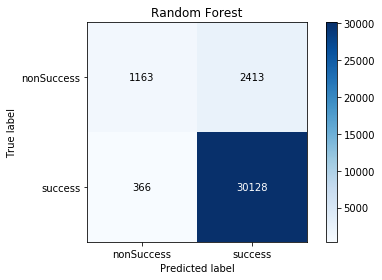

In [16]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support

y_pred_forest = clf_forest_Final.predict(X_test)


cm_forest = confusion_matrix(y_test, y_pred_forest.round())
precision, recall, f_score, support = precision_recall_fscore_support(y_test, y_pred_forest.round())
precision_recall_fscore_support(y_test, y_pred_forest.round())  # per label

print (precision, recall, f_score, support)

normalize = False

fig, ax = plt.subplots()
im = ax.imshow(cm_forest, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)
# We want to show all ticks...
ax.set(xticks=np.arange(cm_forest.shape[1]),
       yticks=np.arange(cm_forest.shape[0]),
       # ... and label them with the respective list entries
       xticklabels=['nonSuccess','success'], yticklabels=['nonSuccess','success'],
       title='Random Forest',
       ylabel='True label',
       xlabel='Predicted label')


fmt = '.2f' if normalize else 'd'
thresh = cm_forest.max() / 2.
for i in range(cm_forest.shape[0]):
    for j in range(cm_forest.shape[1]):
        ax.text(j, i, format(cm_forest[i, j], fmt),
                ha="center", va="center",
                color="white" if cm_forest[i, j] > thresh else "black")
        
fig.tight_layout()

metrics.accuracy_score(y_test, y_pred_forest.round())

In [17]:
# Get numerical feature importances
importances = list(clf_forest_Final.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_cols, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
print feature_importances
#[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

[('targsubtype1', 0.14), ('iyear', 0.09), ('iday', 0.08), ('attacktype1', 0.08), ('weapsubtype1', 0.07), ('targtype1', 0.07), ('imonth', 0.06), ('country', 0.06), ('natlty1', 0.06), ('nperps', 0.05), ('region', 0.04), ('weaptype1', 0.03), ('nperpcap', 0.03), ('specificity', 0.02), ('claimed', 0.02), ('INT_IDEO', 0.02), ('crit3', 0.01), ('multiple', 0.01), ('guncertain1', 0.01), ('claimmode', 0.01), ('INT_LOG', 0.01), ('INT_MISC', 0.01), ('INT_ANY', 0.01), ('resolution', 0.0), ('crit1', 0.0), ('crit2', 0.0), ('suicide', 0.0), ('individual', 0.0), ('compclaim', 0.0)]


In [18]:
# SVM

#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=1) # 70% training and 30% test
#Import svm model
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn import metrics


#Create a svm Classifier
#clf_SVM = svm.SVC(kernel='linear') # Linear Kernel
clf_SVM = LinearSVC()

#Train the model using the training sets
clf_SVM.fit(X_train, y_train)

#Predict the response for test dataset



# Model Accuracy: how often is the classifier correct?
#print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

# Model Precision: what percentage of positive tuples are labeled as such?
#print("Precision:",metrics.precision_score(y_test, y_pred))

# Model Recall: what percentage of positive tuples are labelled as such?
#print("Recall:",metrics.recall_score(y_test, y_pred))

LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
     verbose=0)

(array([0.50943396, 0.89566981]), array([0.00755034, 0.99914737]), array([0.01488013, 0.94458309]), array([ 3576, 30494]))


0.8950689756383915

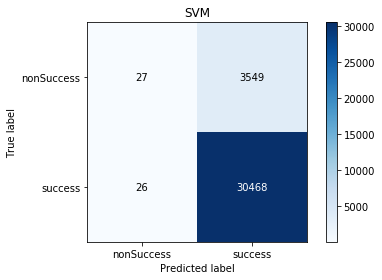

In [19]:
y_pred_svm = clf_SVM.predict(X_test)


cm_svm = confusion_matrix(y_test, y_pred_svm.round())
precision, recall, f_score, support = precision_recall_fscore_support(y_test, y_pred_svm.round())
precision_recall_fscore_support(y_test, y_pred_svm.round())  # per label
print (precision, recall, f_score, support)

fig, ax = plt.subplots()
im = ax.imshow(cm_svm, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)
# We want to show all ticks...
ax.set(xticks=np.arange(cm_svm.shape[1]),
       yticks=np.arange(cm_svm.shape[0]),
       # ... and label them with the respective list entries
       xticklabels=['nonSuccess','success'], yticklabels=['nonSuccess','success'],
       title='SVM',
       ylabel='True label',
       xlabel='Predicted label')



fmt = '.2f' if normalize else 'd'
thresh = cm_svm.max() / 2.
for i in range(cm_svm.shape[0]):
    for j in range(cm_svm.shape[1]):
        ax.text(j, i, format(cm_svm[i, j], fmt),
                ha="center", va="center",
                color="white" if cm_svm[i, j] > thresh else "black")
        
fig.tight_layout()

metrics.accuracy_score(y_test, y_pred_forest.round())
metrics.accuracy_score(y_test, y_pred_svm.round())

AttributeError: 'LinearSVC' object has no attribute 'feature_importances_'

In [365]:
y_pred = clf.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
print cm

ValueError: Classification metrics can't handle a mix of continuous and binary targets

In [269]:
# Apriori algorithm
from apyori import apriori 

association_rules = apriori(selected_df, min_support=0.0045, min_confidence=0.2, min_lift=3, min_length=2)  
association_results = list(association_rules)  

print(type(association_rules))
print(len(association_results))  

for item in association_results:

    # first index of the inner list
    # Contains base item and add item
    pair = item[0] 
    items = [x for x in pair]
    print("Rule: " + items[0] + " -> " + items[1])

    #second index of the inner list
    print("Support: " + str(item[1]))

    #third index of the list located at 0th
    #of the third index of the inner list

    print("Confidence: " + str(item[2][0][2]))
    print("Lift: " + str(item[2][0][3]))
    print("=====================================")

<type 'generator'>
4350
Rule: A -> I
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: A -> N
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: A -> T
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: A -> Y
Support: 0.0243902439024
Confidence: 1.0
Lift: 41.0
Rule: A -> _
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: I -> C
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: C -> M
Support: 0.0243902439024
Confidence: 1.0
Lift: 41.0
Rule: C -> N
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: C -> S
Support: 0.0243902439024
Confidence: 1.0
Lift: 41.0
Rule: C -> T
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: C -> _
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: E -> D
Support: 0.0243902439024
Confidence: 1.0
Lift: 41.0
Rule: I -> D
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: D -> N
Support: 0.0243902439024
Confidence: 1.0
Lift: 10.25
Rule: D -> O
Support: 0.0243902439024
Confidence: 1.0
Li

Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> y
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> s
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> s
Support: 0.0243902439024
Confidence: 0.5
Lift: 5.125
Rule: 1 -> y
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> s
Support: 0.0243902439024
Confidence: 0.5
Lift: 5.125
Rule: 1 -> y
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> y
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> u
Support: 0.0243902439024
Confidence: 0.333333333333
Lift: 3.41666666667
Rule: 1 -> y
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> y
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: i -> c
Support: 0.0243902439024
Confidence: 0.25
Lift: 10.25
Rule: c -> 2
Support: 0.0243902439024
Confidence: 0.2
Lift: 8.2
Rule: i -> 3
Support: 0.0243902439024
Confidence: 0.25
Lift: 10.25
Rule: 3 -> r
Support: 0.0243902

Lift: 3.41666666667
Rule: p -> e
Support: 0.0243902439024
Confidence: 0.5
Lift: 20.5
Rule: y -> p
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.15384615385
Rule: x -> r
Support: 0.0243902439024
Confidence: 0.25
Lift: 10.25
Rule: u -> s
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: x -> e
Support: 0.0243902439024
Confidence: 0.25
Lift: 10.25
Rule: u -> e
Support: 0.0243902439024
Confidence: 0.5
Lift: 5.125
Rule: p -> r
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.15384615385
Rule: p -> s
Support: 0.0487804878049
Confidence: 0.666666666667
Lift: 3.41666666667
Rule: p -> s
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.15384615385
Rule: y -> p
Support: 0.0731707317073
Confidence: 1.0
Lift: 3.15384615385
Rule: p -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.15384615385
Rule: y -> p
Support: 0.170731707317
Confidence: 1.0
Lift: 3.15384615385
Rule: p -> e
Support: 0.0243902439024
Confidence: 0.333333333333
Lift: 3.41666666667
Rule: y -> p
Support: 0.0487

Support: 0.0243902439024
Confidence: 0.333333333333
Lift: 3.41666666667
Rule: 1 -> u
Support: 0.0487804878049
Confidence: 1.0
Lift: 4.1
Rule: 1 -> y
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> u
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> i
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: 1 -> i
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: 1 -> i
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> i
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.1
Rule: 1 -> i
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> i
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> r
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: 1 -> r
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> u
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: 1 -> p
Support: 0.0243902439024
Confidence: 1.0
Lift: 

Lift: 3.41666666667
Rule: y -> r
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: y -> r
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: y -> r
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: s -> b
Support: 0.0243902439024
Confidence: 0.5
Lift: 5.125
Rule: y -> s
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: y -> s
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: y -> s
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: y -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: i -> c
Support: 0.0487804878049
Confidence: 0.666666666667
Lift: 3.03703703704
Rule: i -> m
Support: 0.0487804878049
Confidence: 0.666666666667
Lift: 3.90476190476
Rule: i -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: m -> c
Support: 0.0487804878049
Confidence: 1.0
Lift: 5.85714285714
Rule: c -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.55555555556
Rule

Rule: a -> e
Support: 0.0487804878049
Confidence: 0.666666666667
Lift: 3.90476190476
Rule: a -> e
Support: 0.0487804878049
Confidence: 1.0
Lift: 4.1
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.1
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.1
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.1
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.1
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.15384615385
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.1
Rule: a -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> e


Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0487804878049
Confidence: 1.0
Lift: 5.85714285714
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 4.55555555556
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.15384615385
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> c
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.85714285714
Rule: a -> c
Support: 0.0243902439024
Confidence: 1

Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 5.125
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a -> b
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: a ->

Rule: b -> e
Support: 0.0243902439024
Confidence: 0.5
Lift: 5.125
Rule: b -> e
Support: 0.0487804878049
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> e
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> g
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> g
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> g
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> g
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> g
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> g
Support: 0.0243902439024
Confidence: 1.0
Lift: 3.41666666667
Rule: b -> p
Support: 0.0243902439024
Confiden

In [53]:
# remove Nan columns
a = df.count()
for i in range(0,len(a)):
    
    if a[i] < 100000:
        #print(a.index[i])
        del df[a.index[i]]
del df['dbsource']
df.count()

eventid             170350
iyear               170350
imonth              170350
iday                170350
extended            170350
country             170350
country_txt         170350
region              170350
region_txt          170350
provstate           155848
city                169904
latitude            165744
longitude           165744
specificity         170346
vicinity            170350
summary             104212
crit1               170350
crit2               170350
crit3               170350
doubtterr           170350
multiple            170350
success             170350
suicide             170350
attacktype1         170350
attacktype1_txt     170350
targtype1           170350
targtype1_txt       170350
targsubtype1        161005
targsubtype1_txt    161005
corp1               127784
target1             169714
natlty1             168956
natlty1_txt         168956
gname               170350
guncertain1         169971
individual          170350
nperpcap            100851
c

In [45]:
# extended, success, gname

# df = df.fillna(value=0)
del df['dbsource']
df.head()

,eventid,iyear,imonth,iday,extended,country,country_txt,region,region_txt,vicinity,...,gname,individual,weaptype1,weaptype1_txt,property,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,197000000001,1970,7,2,0,58,Dominican Republic,2,Central America & Caribbean,0,...,MANO-D,0,13,Unknown,0,PGIS,0,0,0,0
1,197000000002,1970,0,0,0,130,Mexico,1,North America,0,...,23rd of September Communist League,0,13,Unknown,0,PGIS,0,1,1,1
2,197001000001,1970,1,0,0,160,Philippines,5,Southeast Asia,0,...,Unknown,0,13,Unknown,0,PGIS,-9,-9,1,1
3,197001000002,1970,1,0,0,78,Greece,8,Western Europe,0,...,Unknown,0,6,Explosives/Bombs/Dynamite,1,PGIS,-9,-9,1,1
4,197001000003,1970,1,0,0,101,Japan,4,East Asia,0,...,Unknown,0,8,Incendiary,1,PGIS,-9,-9,1,1


In [40]:
a = df.count()
print(type(a))
print(a.index[0])

<class 'pandas.core.series.Series'>
eventid


In [24]:
df.to_csv('preprocessing_data', sep=',')

In [16]:
# Data selection
# df_select = df['iyear', 'imonth', 'iday', 'extended', country', 'country_txt', 'region', 'provstate', 'city', ]

df['resolution'].describe()

count         2219
unique        1859
top       8/4/1998
freq            18
Name: resolution, dtype: object

In [10]:
# matrix correlation 
corr = df.corr()
corr.head()


,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
eventid,1.000000,0.999996,0.006579,0.015797,0.090726,-0.138450,0.402518,0.171345,0.553012,0.029614,...,-0.006867,-0.013978,-0.177160,-0.165084,0.276580,-0.215808,-0.161964,-0.152490,-0.077708,-0.193944
iyear,0.999996,1.000000,0.003989,0.015718,0.090716,-0.138433,0.402530,0.171396,0.553031,0.029603,...,-0.006859,-0.014248,-0.177193,-0.165045,0.276577,-0.215725,-0.161970,-0.152497,-0.077702,-0.193941
imonth,0.006579,0.003989,1.000000,0.004970,0.000017,-0.007392,-0.001067,-0.015723,-0.004085,0.002018,...,-0.000940,0.057769,0.000127,-0.017220,0.012434,-0.023320,-0.001348,-0.000668,-0.003443,-0.005439
iday,0.015797,0.015718,0.004970,1.000000,-0.004475,0.004255,0.009347,0.002978,0.010984,-0.009472,...,0.015000,0.004007,0.002760,-0.006437,-0.001443,0.006836,-0.002149,-0.002180,-0.002295,-0.001582
extended,0.090726,0.090716,0.000017,-0.004475,1.000000,-0.021913,0.035899,-0.021142,0.036189,0.056203,...,-0.007422,0.027223,-0.054613,0.013042,0.211536,-0.206767,0.069081,0.072660,0.029269,0.079923


In [15]:
# filter reduing the number of fields
for i in 
corr.sort_values(['eventid'])


KeyError: 0

In [2]:
########################################################################################################################
#  Data Processing for EISIC conference
#
########################################################################################################################

In [ ]:
# TESTING OR CHECKING


In [16]:
# Read data 
selected_df = pd.read_csv("data/selected_final_v2.csv")
del selected_df['Unnamed: 0']
selected_df.head()

,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,region,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,1970,7,2,-10,1,1,1,0,58,2,...,1,-10,0,-10,0,-10,0,0,0,0
1,1970,1,1,-10,1,1,1,0,130,1,...,0,-10,0,-10,0,-10,0,1,1,1
2,1970,1,1,-10,1,1,1,0,160,5,...,1,-10,0,-10,0,-10,-9,-9,1,1
3,1970,1,1,-10,1,1,1,0,78,8,...,-10,-10,-10,-10,1,-10,-9,-9,1,1
4,1970,1,1,-10,1,1,1,0,101,4,...,-10,-10,-10,-10,1,-10,-9,-9,1,1


In [74]:
sort_selected_df = selected_df.sort_values(by=['attacktype1'])
sort_selected_df['attacktype1'].describe()

count    170350.000000
mean          3.220211
std           1.891227
min           1.000000
25%           2.000000
50%           3.000000
75%           3.000000
max           9.000000
Name: attacktype1, dtype: float64

In [40]:
for region, df_region in selected_df.groupby('attacktype1'):
    print(df_region)

        iyear  imonth  iday  resolution  crit1  crit2  crit3  multiple  \
0        1970       7     2         -10      1      1      1         0   
2        1970       1     1         -10      1      1      1         0   
6        1970       1     2         -10      1      1      1         0   
25       1970       1    20         -10      1      1      1         0   
111      1970       3     5         -10      1      1      1         0   
142      1970       3    20         -10      1      1      1         0   
225      1970       4    24         -10      1      1      1         0   
253      1970       5     4         -10      1      1      1         0   
289      1970       5    15         -10      1      1      1         0   
316      1970       6     1         -10      1      1      1         0   
319      1970       6     2         -10      0      1      1         0   
339      1970       6     9         -10      1      1      1         0   
340      1970       6    10         -1

        iyear  imonth  iday  resolution  crit1  crit2  crit3  multiple  \
1        1970       1     1         -10      1      1      1         0   
27       1970       1    22         -10      1      1      1         0   
103      1970       3     3         -10      1      1      1         0   
112      1970       3     6           2      1      1      1         0   
123      1970       3    11           4      1      1      1         0   
132      1970       3    14          17      1      1      1         0   
151      1970       3    24           2      1      1      0         0   
152      1970       3    24           4      1      1      1         0   
157      1970       3    29         -10      1      1      1         0   
161      1970       3    31           5      1      1      1         0   
165      1970       4     1           4      1      1      1         0   
175      1970       4     5         -10      1      1      1         0   
311      1970       5    29          4

In [41]:
df_region.describe()

,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,region,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,...,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000,6425.000000
mean,2003.269105,6.691829,15.429883,-9.921245,0.996420,0.981479,0.748794,0.157977,119.553307,7.383658,...,3.475019,-3.079844,0.531984,-4.542257,-0.926537,-7.813852,-2.794708,-2.663191,0.013696,-2.269105
std,12.834526,3.356696,8.891457,3.304026,0.059729,0.134838,0.433741,0.364747,108.654055,3.024014,...,13.492920,8.759127,8.983187,5.823776,3.435750,5.004751,4.213005,4.349839,0.924180,4.218867
min,1970.000000,1.000000,1.000000,-29.000000,0.000000,0.000000,0.000000,0.000000,4.000000,1.000000,...,-10.000000,-10.000000,-10.000000,-10.000000,-9.000000,-10.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1994.000000,4.000000,8.000000,-10.000000,1.000000,1.000000,0.000000,0.000000,45.000000,6.000000,...,0.000000,-10.000000,0.000000,-10.000000,0.000000,-10.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2010.000000,7.000000,15.000000,-10.000000,1.000000,1.000000,1.000000,0.000000,95.000000,6.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,-10.000000,0.000000,0.000000,0.000000,0.000000
75%,2015.000000,10.000000,23.000000,-10.000000,1.000000,1.000000,1.000000,0.000000,182.000000,10.000000,...,4.000000,0.000000,1.000000,0.000000,1.000000,-10.000000,0.000000,0.000000,0.000000,1.000000
max,2016.000000,12.000000,31.000000,244.000000,1.000000,1.000000,1.000000,1.000000,1004.000000,12.000000,...,375.000000,300.000000,200.000000,60.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000


In [34]:
df_region['attacktype1'].describe()

count    6425.0
mean        9.0
std         0.0
min         9.0
25%         9.0
50%         9.0
75%         9.0
max         9.0
Name: attacktype1, dtype: float64

In [69]:
testing___ =  sort_selected_df['iday'].head(8)
testing_3 = testing___[5:9]
print(testing_3)
testing_3 = testing_3.iloc[1:]
print(testing_3)

125610    12
15650     17
65761      2
Name: iday, dtype: int64
15650    17
65761     2
Name: iday, dtype: int64


In [39]:
# COUNTING
grouped = selected_df.groupby(['attacktype1'])
grouped.describe()

iyear                                                           \
               count         mean        std     min     25%     50%      75%   
attacktype1                                                                     
1            18402.0  1995.249592  13.002047  1970.0  1986.0  1992.0  2010.00   
2            40223.0  2001.996196  12.577837  1970.0  1991.0  2007.0  2014.00   
3            83073.0  2002.936405  12.933027  1970.0  1991.0  2009.0  2014.00   
4              598.0  1997.401338  13.795690  1970.0  1987.0  1996.0  2011.75   
5              902.0  1992.848115  14.501643  1970.0  1981.0  1987.0  2012.00   
6            10233.0  2004.535913  12.408331  1970.0  1996.0  2010.0  2014.00   
7             9581.0  1999.241520  14.052567  1970.0  1988.0  2000.0  2013.00   
8              913.0  2002.560789  10.420379  1970.0  1995.0  2001.0  2013.00   
9             6425.0  2003.269105  12.834526  1970.0  1994.0  2010.0  2015.00   

                      imonth            ... INT_MISC       INT_ANY            \
                max    count      mean  ...      75%  max    count      mean   
attacktype1                             ...                                    
1            2016.0  18402.0  6.382730  ...      0.0  1.0  18402.0 -4.208727   
2            2016.0  40223.0  6.502399  ...      0.0  1.0  40223.0 -3.626333   
3            2016.0  83073.0  6.466987  ...      0.0  1.0  83073.0 -4.482443   
4            2016.0    598.0  6.688963  ...      1.0  1.0    598.0 -2.725753   
5            2016.0    902.0  6.477827  ...      0.0  1.0    902.0 -1.366962   
6            2016.0  10233.0  6.493795  ...      0.0  1.0  10233.0 -2.471807   
7            2016.0   9581.0  6.400898  ...      0.0  1.0   9581.0 -3.686045   
8            2016.0    913.0  6.670318  ...      0.0  1.0    913.0 -3.756846   
9            2016.0   6425.0  6.691829  ...      0.0  1.0   6425.0 -2.269105   

                                                
                  std  min  25%  50%  75%  max  
attacktype1                                     
1            4.741049 -9.0 -9.0  0.0  0.0  1.0  
2            4.575495 -9.0 -9.0  0.0  0.0  1.0  
3            4.720257 -9.0 -9.0 -9.0  0.0  1.0  
4            4.569769 -9.0 -9.0  0.0  1.0  1.0  
5            3.597622 -9.0  0.0  0.0  0.0  1.0  
6            4.371170 -9.0 -9.0  0.0  1.0  1.0  
7            4.701837 -9.0 -9.0  0.0  1.0  1.0  
8            4.688080 -9.0 -9.0  0.0  0.0  1.0  
9            4.218867 -9.0 -9.0  0.0  1.0  1.0  

[9 rows x 280 columns]

In [105]:
df_1 = sort_selected_df.head(18402)
sort_selected_df1 = sort_selected_df.iloc[18402:]

df_2 = sort_selected_df1.head(40223)
sort_selected_df2 = sort_selected_df1.iloc[40223:]

df_3 = sort_selected_df2.head(83073)
sort_selected_df3 = sort_selected_df2.iloc[83073:]

df_4 = sort_selected_df3.head(598)
sort_selected_df4 = sort_selected_df3.iloc[598:]

df_5 = sort_selected_df4.head(902)
sort_selected_df5 = sort_selected_df4.iloc[902:]

df_6 = sort_selected_df5.head(10233)
sort_selected_df6 = sort_selected_df5.iloc[10233:]

df_7 = sort_selected_df6.head(9581)
sort_selected_df7 = sort_selected_df6.iloc[9581:]

df_8 = sort_selected_df7.head(913)
sort_selected_df8 = sort_selected_df7.iloc[913:]

df_9 = sort_selected_df8.head(6425)
sort_selected_df9 = sort_selected_df8.iloc[6425:]


df_3['attacktype1'].head()

122332    3
122648    3
16827     3
121733    3
121162    3
Name: attacktype1, dtype: int64

In [63]:
df_2 = sort_selected_df[18402:58625]
df_2['attacktype1']

60699     2
61159     2
77640     2
50492     2
80565     2
80572     2
80548     2
80552     2
80549     2
78812     2
49957     2
50391     2
61149     2
78814     2
78819     2
80559     2
78820     2
49951     2
78499     2
61501     2
78503     2
61158     2
78849     2
78510     2
77580     2
80556     2
49952     2
77633     2
80554     2
80553     2
         ..
36874     2
14121     2
45431     2
11945     2
45850     2
17006     2
33059     2
17841     2
28128     2
11930     2
12026     2
14122     2
45419     2
16943     2
1398      2
22294     2
6971      2
14031     2
1307      2
45420     2
17873     2
38179     2
38252     2
17884     2
28830     2
28166     2
22252     2
33093     2
31263     2
122332    3
Name: attacktype1, Length: 40224, dtype: int64

In [117]:
df_1['success'].nunique() 
#grouped_df_1 = df_1.groupby(['success'])
#grouped_df_1.describe()
grouped_df_1 = df_1['success'].unique()
a = pd.value_counts(df_1['success'].values, sort=False)
print (a)
print (a[0])
sorted_df_1 = df_1.sort_values(['success'])
sorted_df_1.describe()

0     4279
1    14123
dtype: int64
4279


,iyear,imonth,iday,resolution,crit1,crit2,crit3,multiple,country,region,...,nkill,nkillter,nwound,nwoundte,property,propextent,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,...,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000,18402.000000
mean,1995.249592,6.382730,15.413814,-9.963156,0.967504,0.982991,0.932833,0.024563,162.469025,6.816868,...,1.263450,-6.419520,-0.001032,-6.482828,-0.297957,-8.179654,-4.899794,-4.849853,0.115151,-4.208727
std,13.002047,3.381278,8.813528,2.853496,0.177319,0.129308,0.250317,0.154792,154.452929,2.919652,...,1.979856,4.841835,4.952362,4.783180,2.015959,4.552528,4.517952,4.586056,0.719468,4.741049
min,1970.000000,1.000000,1.000000,-10.000000,0.000000,0.000000,0.000000,0.000000,4.000000,1.000000,...,-10.000000,-10.000000,-10.000000,-10.000000,-9.000000,-10.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1986.000000,4.000000,8.000000,-10.000000,1.000000,1.000000,1.000000,0.000000,83.000000,5.000000,...,1.000000,-10.000000,0.000000,-10.000000,0.000000,-10.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,1992.000000,6.000000,15.000000,-10.000000,1.000000,1.000000,1.000000,0.000000,147.000000,6.000000,...,1.000000,-10.000000,0.000000,-10.000000,0.000000,-10.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2010.000000,9.000000,23.000000,-10.000000,1.000000,1.000000,1.000000,0.000000,183.000000,10.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,-10.000000,0.000000,0.000000,0.000000,0.000000
max,2016.000000,12.000000,31.000000,366.000000,1.000000,1.000000,1.000000,1.000000,1004.000000,12.000000,...,54.000000,15.000000,300.000000,7.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000


In [156]:
## using Kmeans to reduce the number of success attacks

def cal_suc(df):
    # Sort the data frame based on their success values
    sorted_df = df.sort_values(['success'])
    
    # counter the number of success and unsuccess
    counter_diff_values = pd.value_counts(df_1['success'].values, sort=False)
    print (counter_diff_values)
    
    # Split the dataframe into two part (success and unsuccess)
    df_unsucsess =  sorted_df.head(counter_diff_values[0])
    df_success = sorted_df.iloc[counter_diff_values[0]:]
    
    # build a kmean model with 
    model_kmeans = KMeans(n_clusters=counter_diff_values[0])
    
    model_kmeans.fit(df_success)
    centeroids = model_kmeans.cluster_centers_
    
    # Format results as a DataFrame
    results = pd.DataFrame(data=model_kmeans.cluster_centers_,columns = df.columns)
    results.count()
    
    return [df_unsucsess, results]

In [ ]:
# remove string/object variables

del df_1['city']
del df_1['corp1']
del df_1['target1']
del df_1['gsubname']
del df_1['gname']
df_1.dtypes

In [171]:
unsuc_suc = cal_suc(df_1)
#df_1_dummified =  pd.get_dummies(df_1)
#df_1_columns = df_1_dummified.columns

#abc = unsuc_suc.cluster_centers_
#print len(abc)
#print abc
print df_1.columns

#result = pd.DataFrame(data=unsuc_suc.cluster_centers_,columns = df_1.columns)
#result.count()

unsuc_suc[1].count()
#unsuc_suc[1].dtypes()

0     4279
1    14123
dtype: int64
Index([u'iyear', u'imonth', u'iday', u'resolution', u'crit1', u'crit2',
       u'crit3', u'multiple', u'country', u'region', u'specificity',
       u'attacktype1', u'success', u'suicide', u'weaptype1', u'weapsubtype1',
       u'targtype1', u'targsubtype1', u'natlty1', u'guncertain1',
       u'individual', u'nperps', u'nperpcap', u'claimed', u'claimmode',
       u'compclaim', u'nkill', u'nkillter', u'nwound', u'nwoundte',
       u'property', u'propextent', u'INT_LOG', u'INT_IDEO', u'INT_MISC',
       u'INT_ANY'],
      dtype='object')


iyear           4279
imonth          4279
iday            4279
resolution      4279
crit1           4279
crit2           4279
crit3           4279
multiple        4279
country         4279
region          4279
specificity     4279
attacktype1     4279
success         4279
suicide         4279
weaptype1       4279
weapsubtype1    4279
targtype1       4279
targsubtype1    4279
natlty1         4279
guncertain1     4279
individual      4279
nperps          4279
nperpcap        4279
claimed         4279
claimmode       4279
compclaim       4279
nkill           4279
nkillter        4279
nwound          4279
nwoundte        4279
property        4279
propextent      4279
INT_LOG         4279
INT_IDEO        4279
INT_MISC        4279
INT_ANY         4279
dtype: int64

In [170]:
unsuc_suc[1].dtypes()

TypeError: 'Series' object is not callable

In [ ]:
#################################################################################
#   Testing classification
##################################################################################

In [173]:
# Features and Target

feature_cols = ['iyear','imonth','iday','resolution','crit1','crit2','crit3','multiple',
                  'country',#'region',#'city',
                'specificity',
                  'attacktype1','suicide',
                  'weaptype1','weapsubtype1',
                  'targtype1','targsubtype1',#'corp1','target1',
                'natlty1', 
                # 'success', 
                  #'gname','gsubname',
                'guncertain1','individual','nperps','nperpcap','claimed','claimmode','compclaim',
                #'nkill','nkillter','nwound','nwoundte','property','propextent',
                  'INT_LOG','INT_IDEO','INT_MISC','INT_ANY']

#X_success = unsuc_suc[1][feature_cols] # Features
#y_success = unsuc_suc[1].success # Target variable

#X_unsucce = unsuc_suc[0][feature_cols] # Features
#y_unsucce = unsuc_suc[0].success # Target variable

#X_train_success, X_test_success, y_train_success, y_test_success = train_test_split(X, y, test_size=0.2, random_state=1) # 80% training and 20% test
#X_train_unsucce, X_test_unsucce, y_train_unsucce, y_test_unsucce = train_test_split(X, y, test_size=0.2, random_state=1) # 80% training and 20% test

combine_df_1 = unsuc_suc[0].append(unsuc_suc[1])

X = combine_df_1[feature_cols] # Features
y = combine_df_1.success # Target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=5) # 80% training and 20% test

# Create Decision Tree classifer object
clf = DecisionTreeClassifier()

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

('Accuracy:', 0.7046038794110774)
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.833575 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.833575 to fit

